<a href="https://colab.research.google.com/github/KozhevnikovAlexandr/zootopia-project/blob/main/networks/Inception_sigmoid.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from keras.applications.inception_v3 import InceptionV3
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Activation, Dropout, Flatten, Dense
from keras.optimizers import SGD
from keras.losses import SparseCategoricalCrossentropy
from google.colab import files
from tensorflow.python.keras.models import load_model
from matplotlib import pyplot as plt
from PIL import Image
import numpy as np
from google.colab import drive
import zipfile
import shutil
import cv2 as cv
from keras import losses
import os
from keras.optimizers import Adam
from matplotlib import pyplot as plt

In [ ]:
# Путь к фотографиям с телефонами для обучения
phone_path = '/content/phone_my_240'
# Путь к фотографиям без телефонов для обучения
no_phone_path = '/content/no_phone_my_240'
# Путь к фото с телефоном для тестирования
test_phone_path = '/content/test_phone_my r'
# Путь к фото без телефонов для тестирования
test_no_phone_path = '/content/test_no_phone_my r'
# Путь к фото с вебок для тестирования 
work_test = '/content/work_test 1'
# Размеры изображения
img_width, img_height = 240, 240
# Размерность тензора на основе изображения для входных данных в нейронную сеть
input_shape = (img_width, img_height, 3)
# Размер мини-выборки 
batch_size = 100
# Количество изображений для обучения
train_imgs = 1665 
#Количество эпох
epochs_count = 10
#Количество нейронов на полносвязном слое
dense_count = 1024
x_train = []
x_test = []
x_work = []

In [ ]:
#подключение гугл диска
!mkdir /content/drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
def unzip(path):
  z = zipfile.ZipFile(path, 'r')
  z.extractall()

In [ ]:
#распаковка архивов
unzip('/content/drive/My Drive/phone_my_240.zip')
unzip('/content/drive/My Drive/no_phone_my_240.zip')
unzip('/content/drive/My Drive/test_phone_my r.zip')
unzip('/content/drive/My Drive/test_no_phone_my r.zip')
unzip('/content/drive/My Drive/work_test 1.zip')

In [ ]:
def photo_to_array(array, path):
  for root, dirs, files in os.walk(path):
    for file in files:
      array.append(np.asarray(Image.open(os.path.join(path, file)).convert('RGB')))

In [ ]:
photo_to_array(x_train, phone_path)
photo_to_array(x_train, no_phone_path)
photo_to_array(x_test, test_phone_path)
photo_to_array(x_test, test_no_phone_path)
photo_to_array(x_work, work_test)

In [ ]:
def make_y(phone_count, no_phone_count):
  y = [1 for i in range(phone_count)] + [0 for i in range(no_phone_count)]
  return np.array(y)

In [ ]:
y_train = make_y(881, 784)
y_test = make_y(74, 92)
y_work = make_y(70, 0)

In [ ]:
x_train = np.array(x_train)
x_test = np.array(x_test)
x_work = np.array(x_work)

In [ ]:
#инициализация готовой части сети
inception = InceptionV3(weights='imagenet', include_top=False, input_shape=input_shape)
#отключение обучения уже обученной части
inception.trainable = False

87916544/87910968 [==============================] - 1s 0us/step


In [ ]:
#инициализация сети, добавление слоев
model = Sequential()
model.add(inception)
model.add(Flatten())
model.add(Dense(dense_count))
model.add(Activation('relu'))
model.add(Dropout(0.5))
model.add(Dense(1))
model.add(Activation('sigmoid'))

In [ ]:
#компиляция модели
#фунуция ошибок - среднекватратичная 
#оптимизатор Adam
model.compile(loss=losses.mean_squared_error,
              optimizer=Adam(lr=1e-5), 
              metrics=['accuracy'])

In [ ]:
model.fit(x = x_train, y = y_train,
          steps_per_epoch=len(y_train) // batch_size,
          epochs=epochs_count,
          shuffle = True,
          validation_split=0.1)

Epoch 1/10
16/16 [==============================] - 193s 12s/step - loss: 0.4484 - accuracy: 0.5471 - val_loss: 0.0255 - val_accuracy: 0.9701
Epoch 2/10
16/16 [==============================] - 185s 12s/step - loss: 0.3641 - accuracy: 0.6290 - val_loss: 0.1493 - val_accuracy: 0.8503
Epoch 3/10
16/16 [==============================] - 196s 12s/step - loss: 0.2680 - accuracy: 0.7279 - val_loss: 0.0836 - val_accuracy: 0.9162
Epoch 4/10
16/16 [==============================] - 188s 12s/step - loss: 0.3013 - accuracy: 0.6955 - val_loss: 0.5984 - val_accuracy: 0.3952
Epoch 5/10
16/16 [==============================] - 187s 12s/step - loss: 0.2539 - accuracy: 0.7438 - val_loss: 0.1745 - val_accuracy: 0.8263
Epoch 6/10
16/16 [==============================] - 185s 12s/step - loss: 0.2283 - accuracy: 0.7679 - val_loss: 0.2106 - val_accuracy: 0.7904
Epoch 7/10
16/16 [==============================] - 185s 12s/step - loss: 0.2054 - accuracy: 0.7859 - val_loss: 0.2307 - val_accuracy: 0.7665
Epoch 

In [ ]:
def get_predict(file):
  i = np.asarray(Image.open(file).convert('RGB'))
  i = np.expand_dims(i, axis=0)
  r = model.predict(i)
  if r[0] >= 0.95: 
    ans = "phone"
  else:
    ans = "no"
  return (r, ans)

In [ ]:
def show_predict(file):
  print(get_predict(file))
  im = cv.imread(file)
  plt.imshow(im, interpolation='nearest')
  plt.show()

In [ ]:
model.evaluate(x_test, y_test)

6/6 [==============================] - 18s 3s/step - loss: 0.0807 - accuracy: 0.9096


[0.08067937195301056, 0.9096385836601257]

In [ ]:
model.evaluate(x_work, y_work)

3/3 [==============================] - 11s 3s/step - loss: 0.1143 - accuracy: 0.8857


[0.11428374797105789, 0.8857142925262451]

(array([[6.307571e-16]], dtype=float32), 'no')


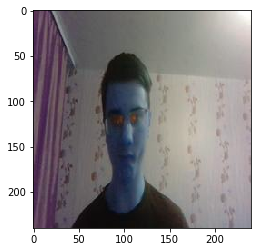

(array([[5.1498757e-24]], dtype=float32), 'no')


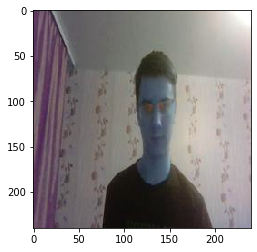

(array([[4.9964956e-06]], dtype=float32), 'no')


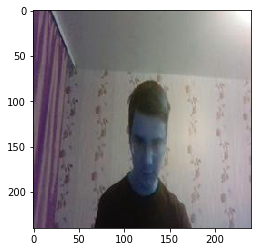

(array([[3.6120867e-32]], dtype=float32), 'no')


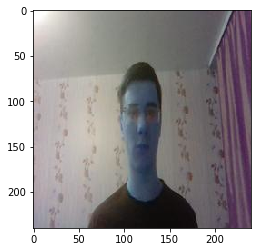

(array([[6.7660627e-10]], dtype=float32), 'no')


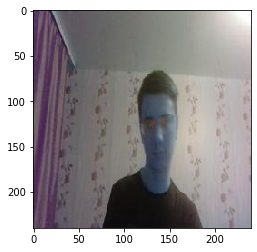

(array([[3.717051e-16]], dtype=float32), 'no')


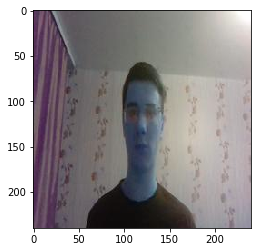

(array([[8.544497e-21]], dtype=float32), 'no')


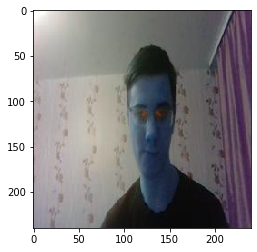

(array([[1.661609e-14]], dtype=float32), 'no')


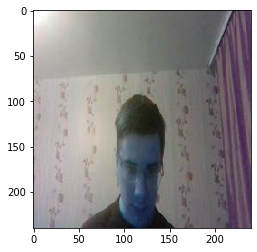

(array([[1.8788633e-26]], dtype=float32), 'no')


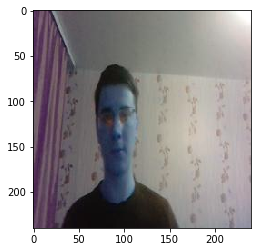

(array([[0.99644107]], dtype=float32), 'phone')


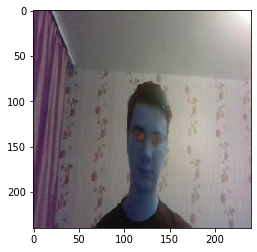

(array([[1.2142217e-15]], dtype=float32), 'no')


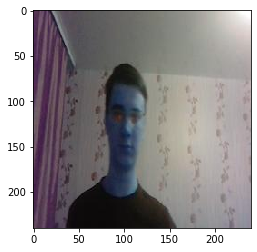

(array([[5.7038603e-21]], dtype=float32), 'no')


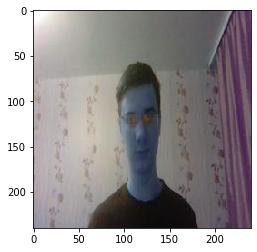

(array([[6.9310653e-07]], dtype=float32), 'no')


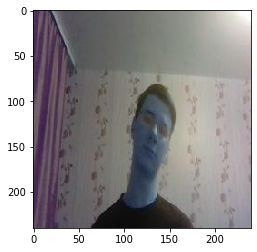

(array([[2.4915207e-19]], dtype=float32), 'no')


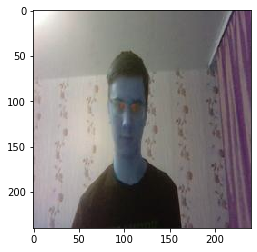

(array([[4.0639364e-17]], dtype=float32), 'no')


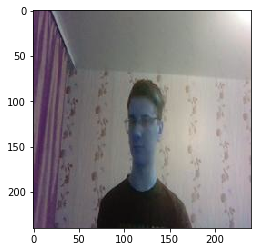

(array([[1.0142796e-24]], dtype=float32), 'no')


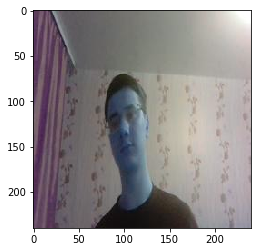

(array([[5.6440524e-15]], dtype=float32), 'no')


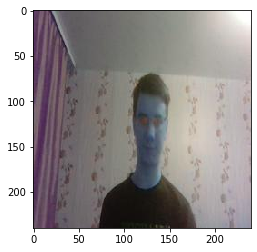

(array([[1.1322276e-16]], dtype=float32), 'no')


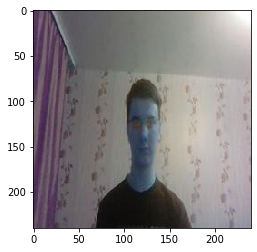

(array([[1.32779485e-08]], dtype=float32), 'no')


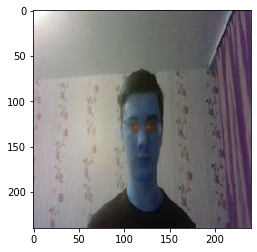

(array([[4.5109337e-15]], dtype=float32), 'no')


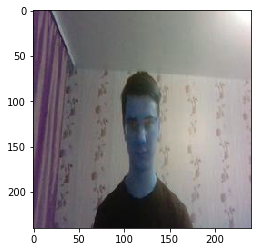

(array([[2.4815673e-14]], dtype=float32), 'no')


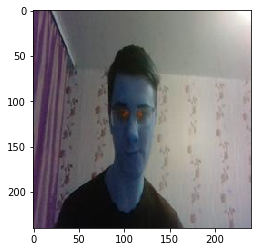

(array([[0.]], dtype=float32), 'no')


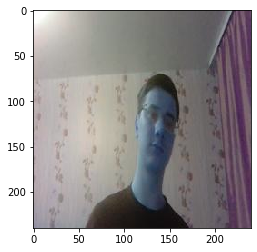

(array([[5.6295316e-06]], dtype=float32), 'no')


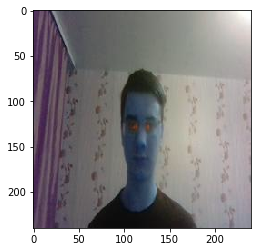

(array([[7.618816e-22]], dtype=float32), 'no')


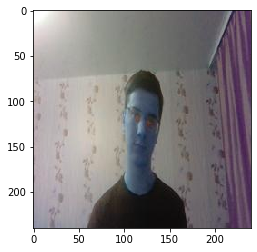

(array([[3.4054713e-16]], dtype=float32), 'no')


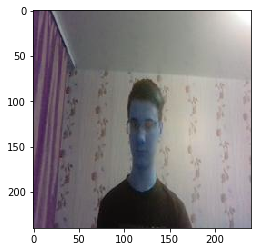

(array([[2.4926319e-20]], dtype=float32), 'no')


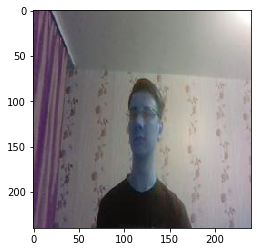

(array([[1.]], dtype=float32), 'phone')


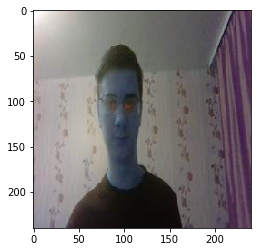

(array([[0.9999974]], dtype=float32), 'phone')


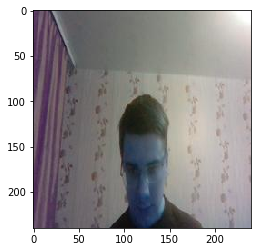

(array([[5.9852484e-25]], dtype=float32), 'no')


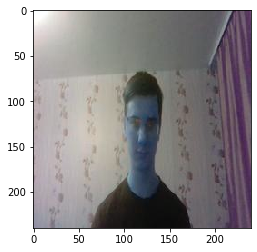

(array([[0.3028851]], dtype=float32), 'no')


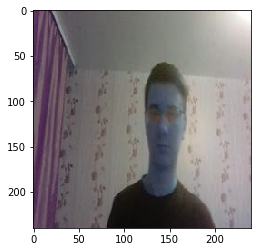

(array([[1.7535959e-15]], dtype=float32), 'no')


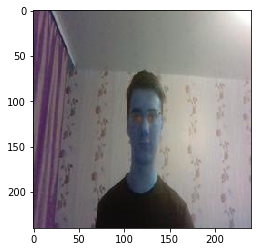

(array([[9.303954e-28]], dtype=float32), 'no')


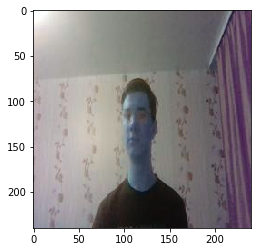

(array([[4.0970438e-10]], dtype=float32), 'no')


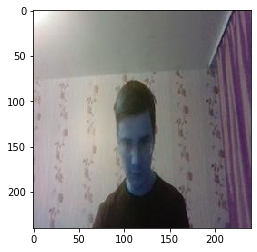

(array([[3.176641e-12]], dtype=float32), 'no')


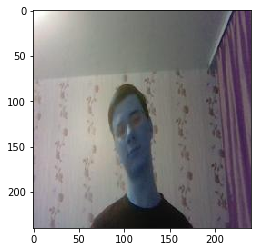

(array([[3.9177044e-29]], dtype=float32), 'no')


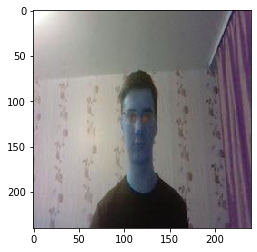

(array([[4.3898764e-16]], dtype=float32), 'no')


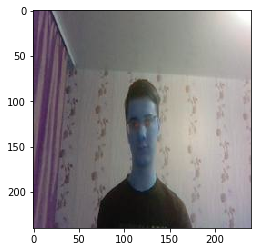

(array([[1.5495682e-05]], dtype=float32), 'no')


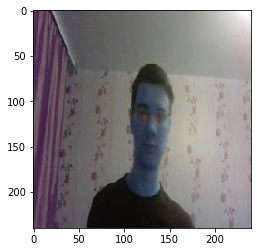

(array([[5.923771e-14]], dtype=float32), 'no')


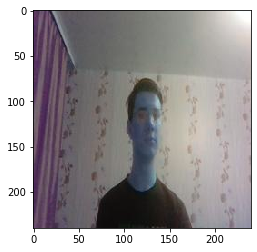

(array([[1.5229262e-26]], dtype=float32), 'no')


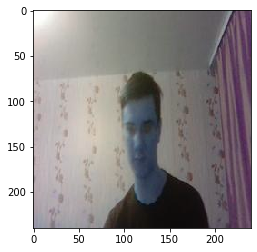

(array([[5.7153557e-15]], dtype=float32), 'no')


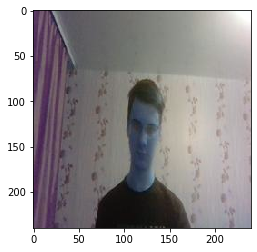

(array([[0.095604]], dtype=float32), 'no')


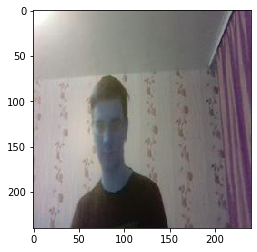

(array([[6.432717e-11]], dtype=float32), 'no')


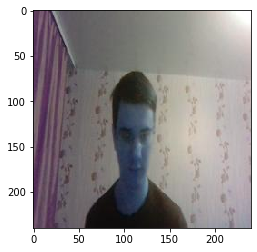

(array([[1.6089179e-10]], dtype=float32), 'no')


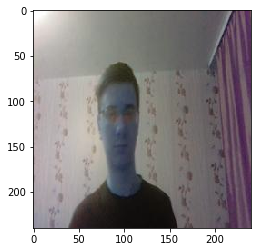

(array([[8.247853e-34]], dtype=float32), 'no')


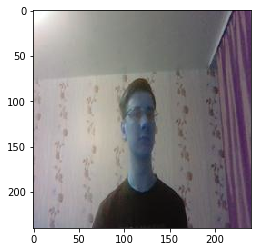

(array([[3.7328476e-26]], dtype=float32), 'no')


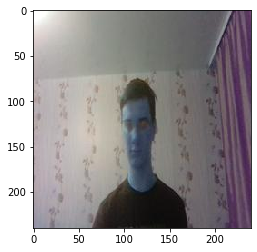

(array([[6.9898556e-19]], dtype=float32), 'no')


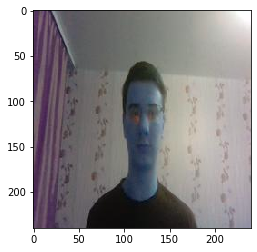

(array([[1.4250298e-19]], dtype=float32), 'no')


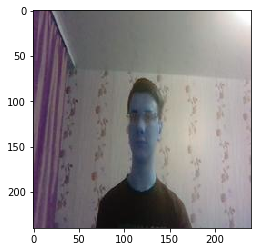

(array([[1.959165e-14]], dtype=float32), 'no')


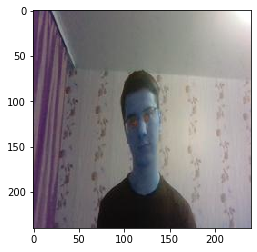

(array([[1.8801357e-15]], dtype=float32), 'no')


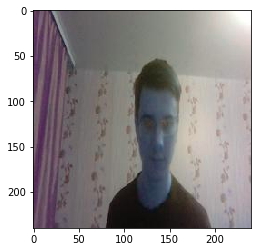

(array([[2.1690032e-18]], dtype=float32), 'no')


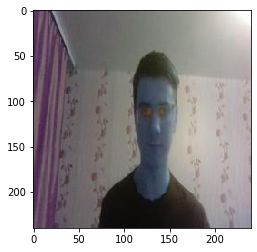

(array([[0.]], dtype=float32), 'no')


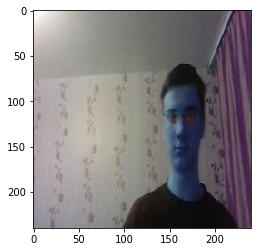

(array([[4.1733264e-33]], dtype=float32), 'no')


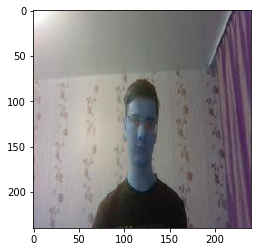

(array([[2.7971656e-11]], dtype=float32), 'no')


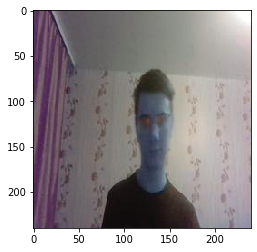

(array([[1.0281682e-30]], dtype=float32), 'no')


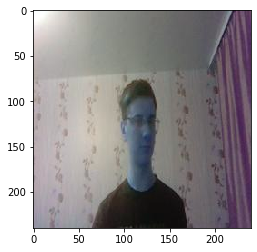

(array([[1.1892461e-25]], dtype=float32), 'no')


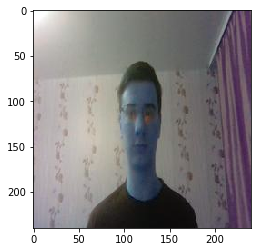

(array([[6.6937163e-22]], dtype=float32), 'no')


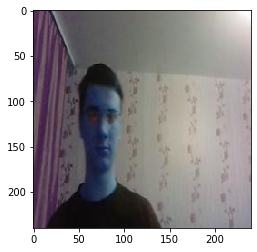

(array([[1.]], dtype=float32), 'phone')


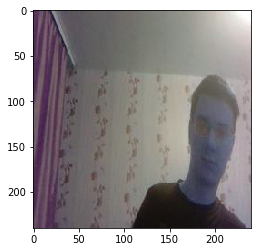

(array([[2.3267275e-24]], dtype=float32), 'no')


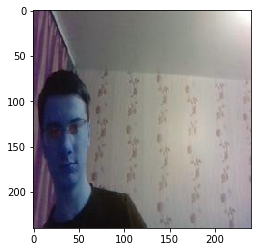

(array([[0.89202]], dtype=float32), 'no')


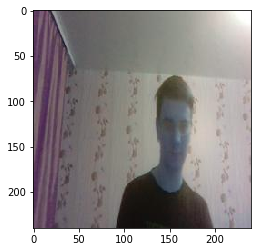

(array([[2.625491e-29]], dtype=float32), 'no')


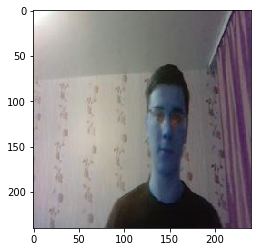

(array([[4.252344e-14]], dtype=float32), 'no')


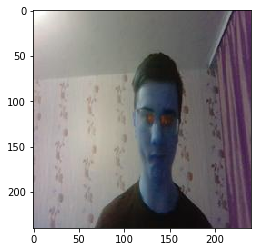

(array([[1.]], dtype=float32), 'phone')


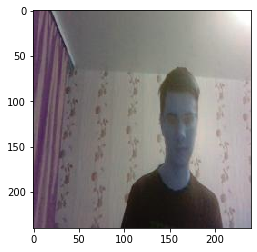

(array([[4.4141123e-29]], dtype=float32), 'no')


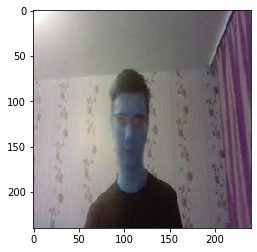

(array([[5.457388e-26]], dtype=float32), 'no')


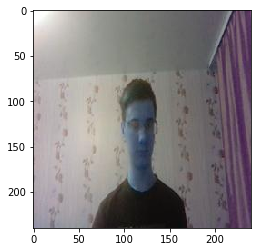

(array([[1.0691497e-16]], dtype=float32), 'no')


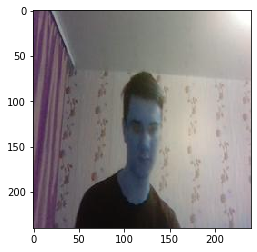

(array([[3.1749435e-13]], dtype=float32), 'no')


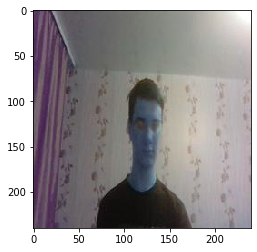

(array([[1.2779022e-31]], dtype=float32), 'no')


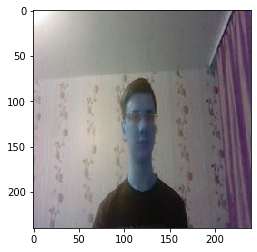

(array([[1.4113519e-29]], dtype=float32), 'no')


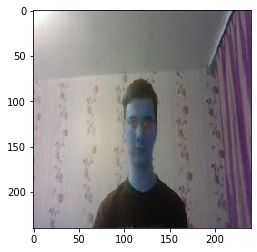

(array([[4.5473634e-26]], dtype=float32), 'no')


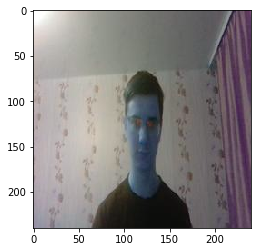

(array([[5.0074366e-05]], dtype=float32), 'no')


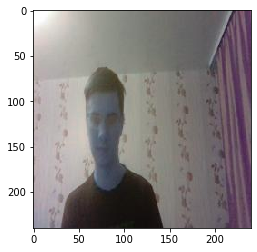

(array([[4.8944484e-09]], dtype=float32), 'no')


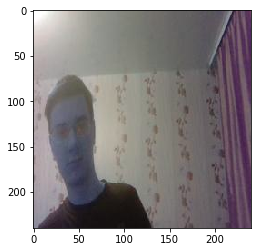

(array([[5.7470006e-06]], dtype=float32), 'no')


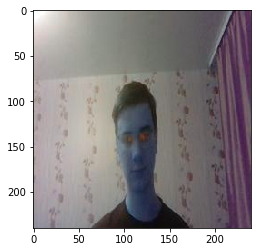

(array([[7.2218085e-09]], dtype=float32), 'no')


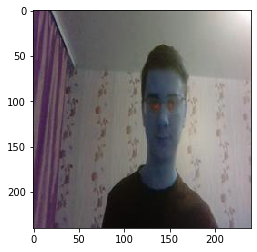

(array([[0.]], dtype=float32), 'no')


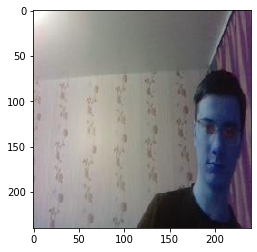

(array([[0.01321387]], dtype=float32), 'no')


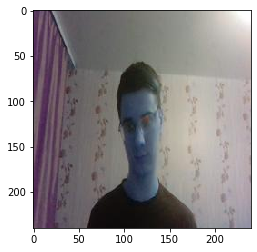

(array([[1.]], dtype=float32), 'phone')


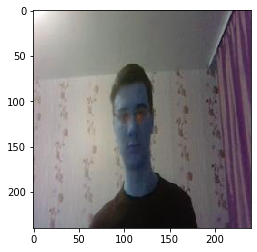

(array([[5.1443675e-13]], dtype=float32), 'no')


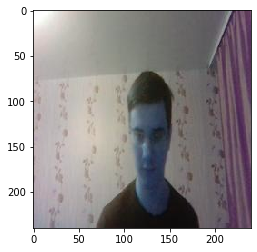

(array([[5.648438e-18]], dtype=float32), 'no')


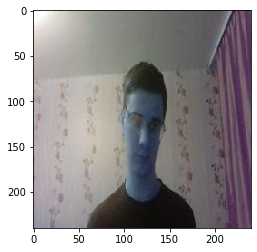

(array([[1.7962284e-16]], dtype=float32), 'no')


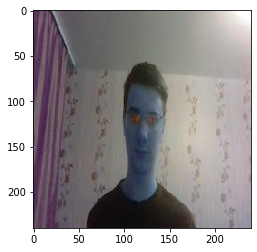

(array([[6.8261263e-15]], dtype=float32), 'no')


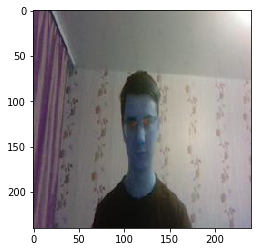

(array([[9.310851e-26]], dtype=float32), 'no')


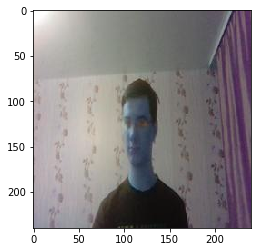

(array([[1.3128687e-12]], dtype=float32), 'no')


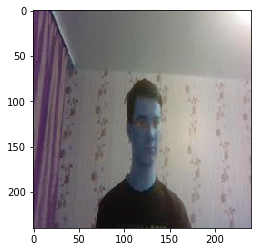

(array([[4.367587e-19]], dtype=float32), 'no')


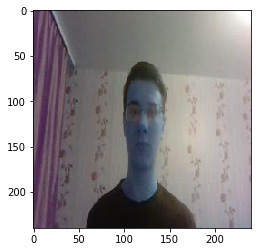

(array([[2.968449e-11]], dtype=float32), 'no')


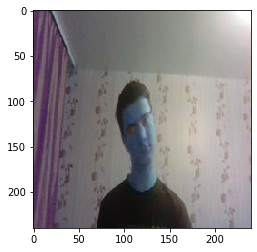

(array([[9.236697e-27]], dtype=float32), 'no')


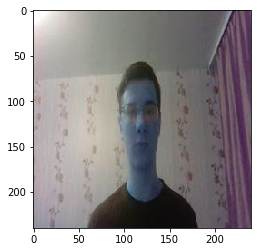

(array([[5.5320628e-21]], dtype=float32), 'no')


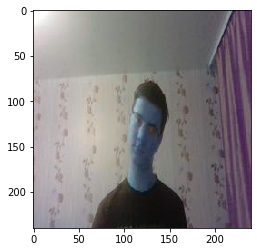

(array([[5.8961334e-36]], dtype=float32), 'no')


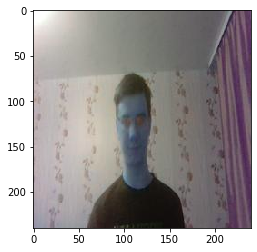

(array([[9.7755937e-29]], dtype=float32), 'no')


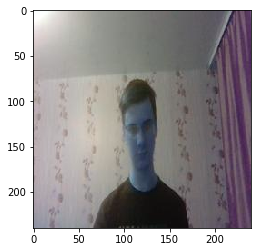

(array([[8.7530845e-09]], dtype=float32), 'no')


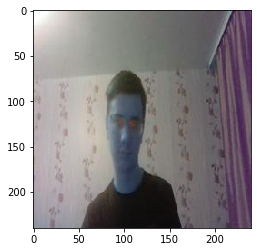

(array([[0.59689265]], dtype=float32), 'no')


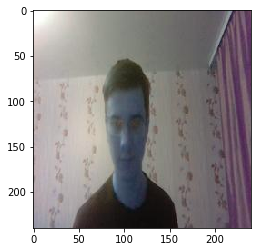

(array([[7.2160194e-22]], dtype=float32), 'no')


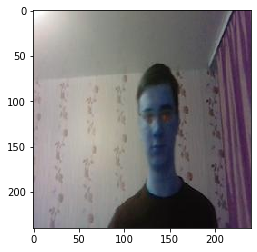

(array([[1.8911803e-06]], dtype=float32), 'no')


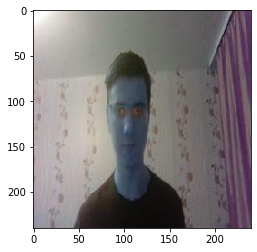

In [ ]:
for root, dirs, files in os.walk(test_no_phone_path):
    for file in files:
      show_predict(os.path.join(test_no_phone_path, file))

(array([[1.]], dtype=float32), 'phone')


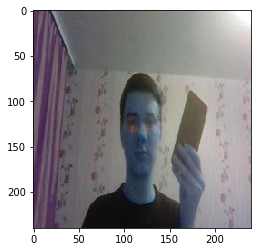

(array([[1.]], dtype=float32), 'phone')


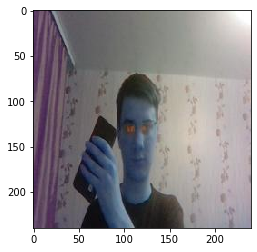

(array([[1.]], dtype=float32), 'phone')


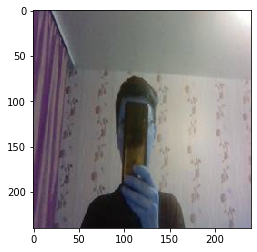

(array([[1.]], dtype=float32), 'phone')


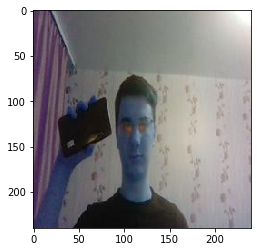

(array([[1.]], dtype=float32), 'phone')


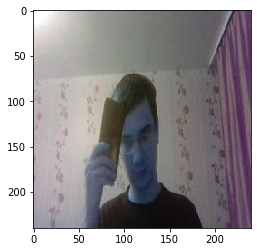

(array([[1.]], dtype=float32), 'phone')


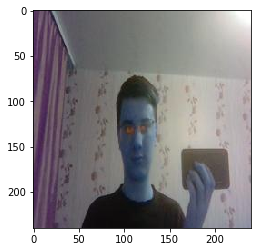

(array([[0.00013345]], dtype=float32), 'no')


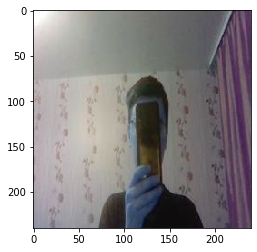

(array([[1.]], dtype=float32), 'phone')


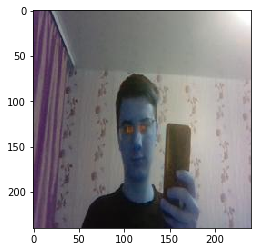

(array([[1.]], dtype=float32), 'phone')


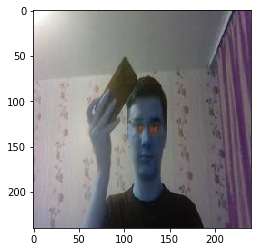

(array([[0.13933948]], dtype=float32), 'no')


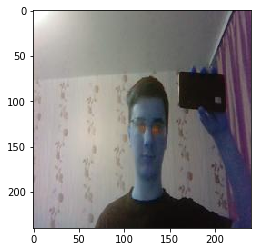

(array([[1.]], dtype=float32), 'phone')


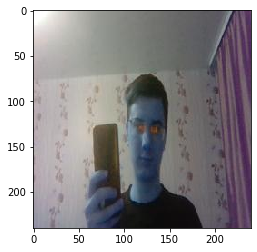

(array([[1.]], dtype=float32), 'phone')


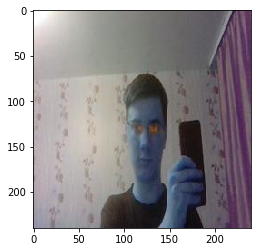

(array([[1.]], dtype=float32), 'phone')


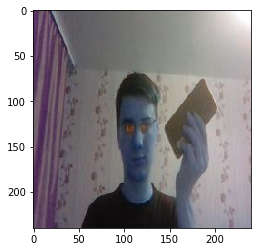

(array([[1.]], dtype=float32), 'phone')


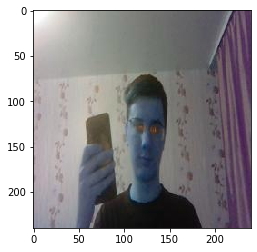

(array([[1.]], dtype=float32), 'phone')


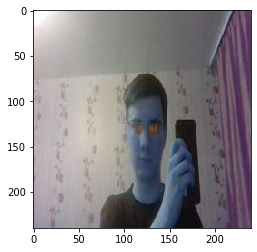

(array([[1.]], dtype=float32), 'phone')


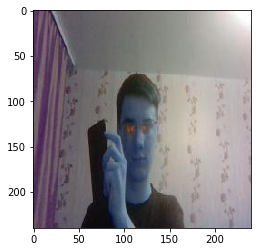

(array([[1.]], dtype=float32), 'phone')


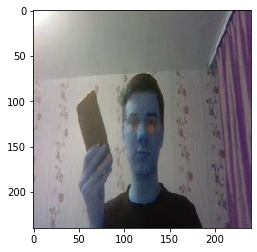

(array([[5.747159e-10]], dtype=float32), 'no')


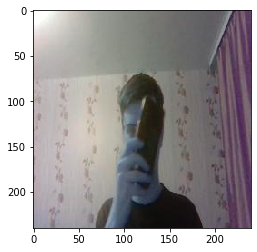

(array([[1.]], dtype=float32), 'phone')


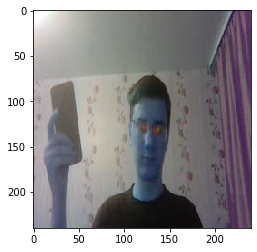

(array([[1.]], dtype=float32), 'phone')


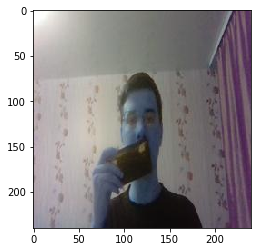

(array([[1.]], dtype=float32), 'phone')


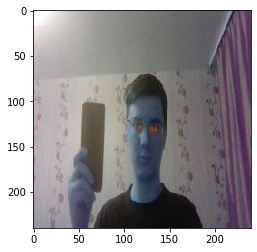

(array([[1.]], dtype=float32), 'phone')


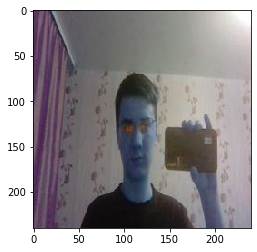

(array([[1.]], dtype=float32), 'phone')


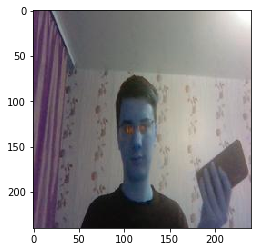

(array([[1.]], dtype=float32), 'phone')


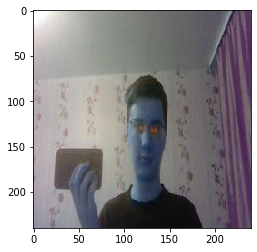

(array([[1.]], dtype=float32), 'phone')


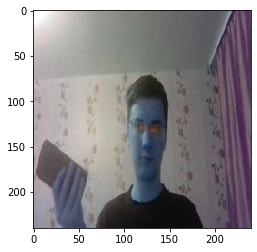

(array([[1.]], dtype=float32), 'phone')


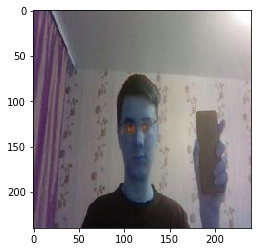

(array([[1.]], dtype=float32), 'phone')


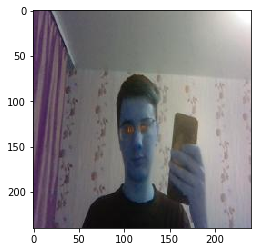

(array([[0.3396872]], dtype=float32), 'no')


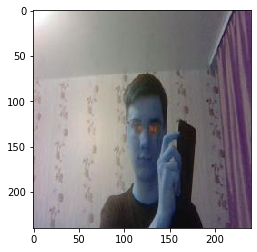

(array([[1.]], dtype=float32), 'phone')


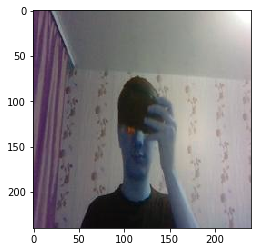

(array([[1.]], dtype=float32), 'phone')


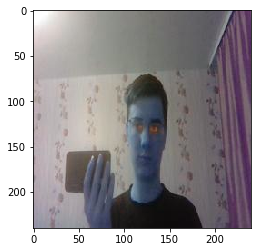

(array([[1.]], dtype=float32), 'phone')


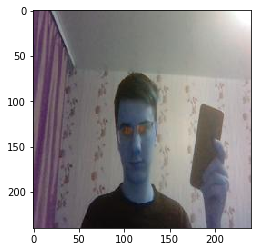

(array([[1.]], dtype=float32), 'phone')


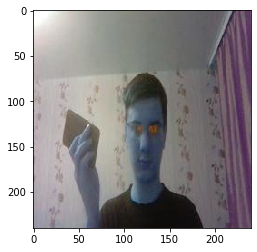

(array([[1.]], dtype=float32), 'phone')


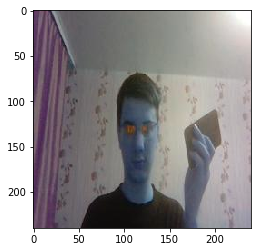

(array([[1.]], dtype=float32), 'phone')


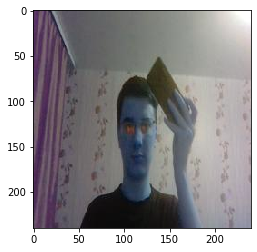

(array([[1.]], dtype=float32), 'phone')


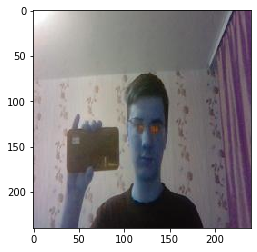

(array([[1.]], dtype=float32), 'phone')


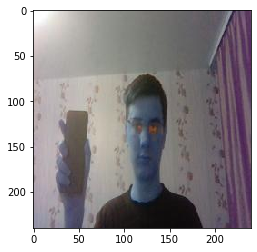

(array([[1.]], dtype=float32), 'phone')


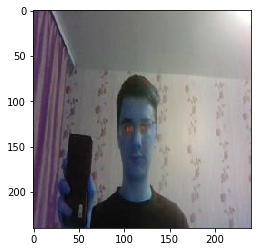

(array([[0.9998747]], dtype=float32), 'phone')


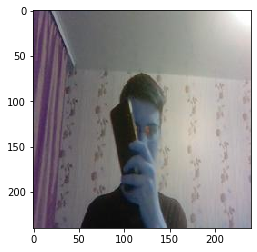

(array([[0.99979365]], dtype=float32), 'phone')


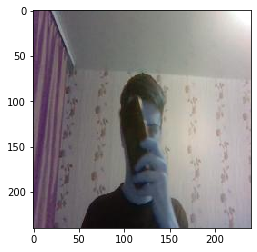

(array([[2.92613e-06]], dtype=float32), 'no')


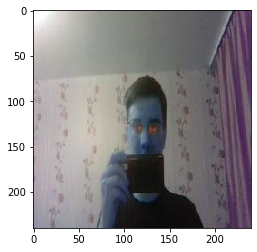

(array([[1.]], dtype=float32), 'phone')


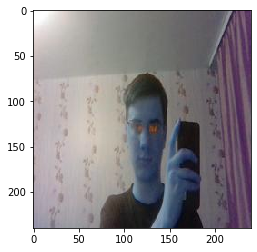

(array([[1.]], dtype=float32), 'phone')


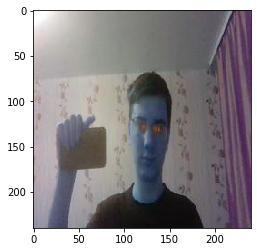

(array([[1.]], dtype=float32), 'phone')


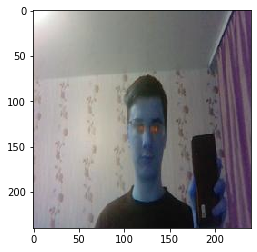

(array([[1.]], dtype=float32), 'phone')


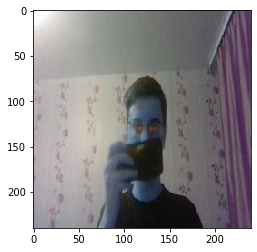

(array([[1.]], dtype=float32), 'phone')


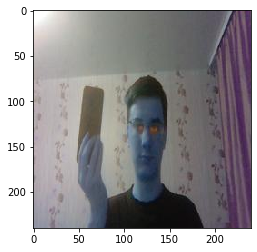

(array([[1.]], dtype=float32), 'phone')


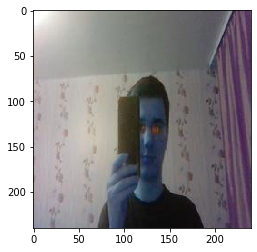

(array([[1.]], dtype=float32), 'phone')


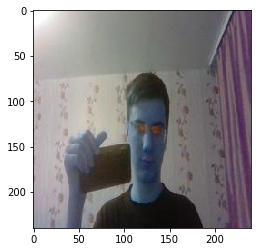

(array([[0.9830415]], dtype=float32), 'phone')


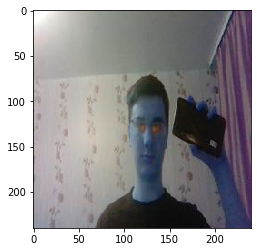

(array([[1.]], dtype=float32), 'phone')


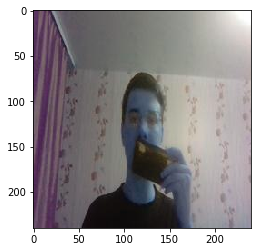

(array([[1.]], dtype=float32), 'phone')


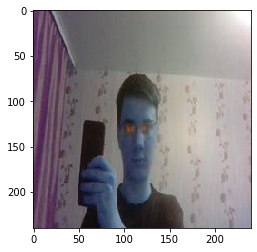

(array([[1.]], dtype=float32), 'phone')


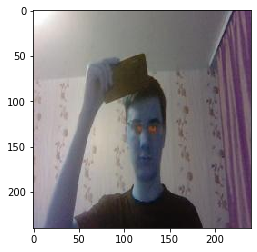

(array([[1.]], dtype=float32), 'phone')


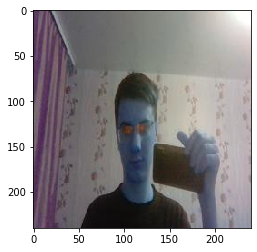

(array([[1.]], dtype=float32), 'phone')


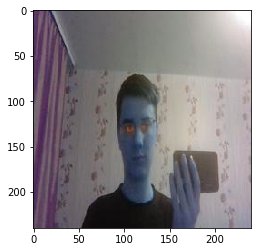

(array([[1.]], dtype=float32), 'phone')


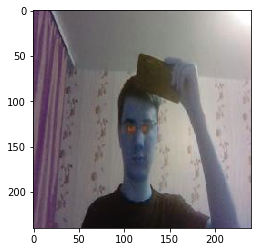

(array([[1.]], dtype=float32), 'phone')


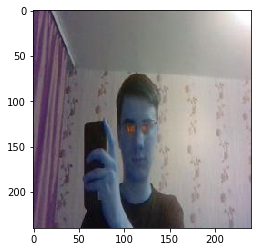

(array([[1.]], dtype=float32), 'phone')


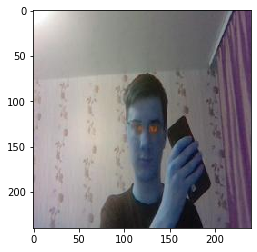

(array([[1.]], dtype=float32), 'phone')


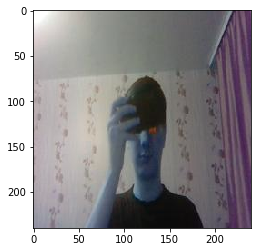

(array([[1.]], dtype=float32), 'phone')


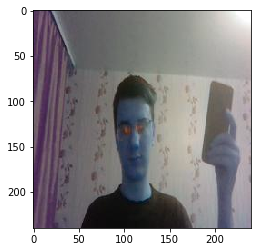

(array([[1.]], dtype=float32), 'phone')


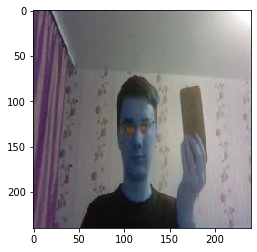

(array([[1.]], dtype=float32), 'phone')


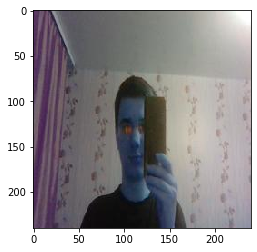

(array([[0.01512507]], dtype=float32), 'no')


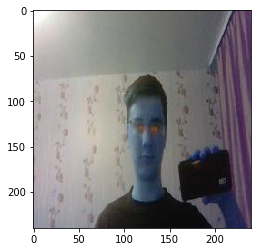

(array([[1.]], dtype=float32), 'phone')


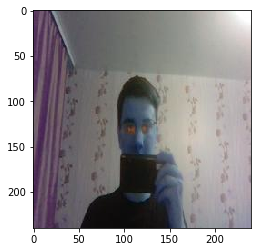

(array([[9.8895525e-06]], dtype=float32), 'no')


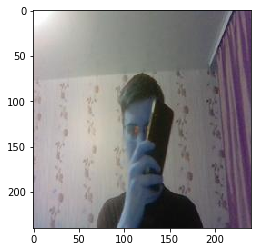

(array([[1.]], dtype=float32), 'phone')


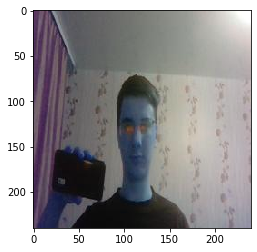

(array([[1.]], dtype=float32), 'phone')


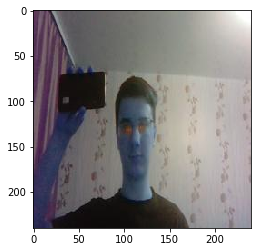

(array([[1.]], dtype=float32), 'phone')


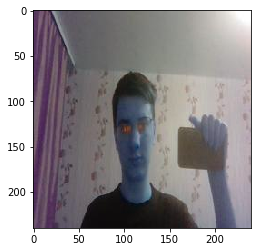

(array([[1.]], dtype=float32), 'phone')


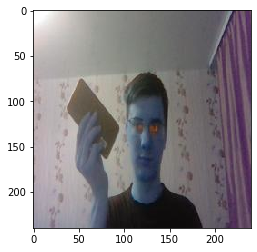

(array([[0.99067736]], dtype=float32), 'phone')


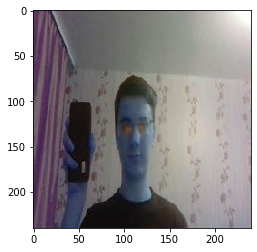

(array([[0.9998892]], dtype=float32), 'phone')


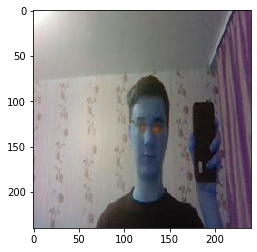

(array([[1.]], dtype=float32), 'phone')


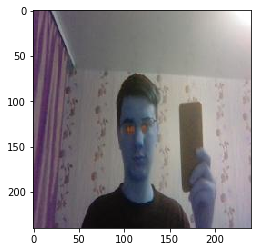

(array([[1.]], dtype=float32), 'phone')


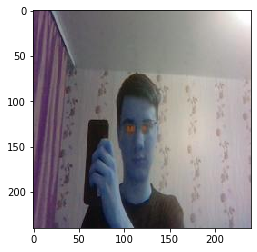

(array([[1.]], dtype=float32), 'phone')


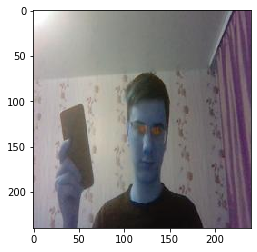

(array([[1.]], dtype=float32), 'phone')


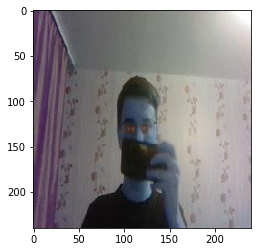

(array([[1.]], dtype=float32), 'phone')


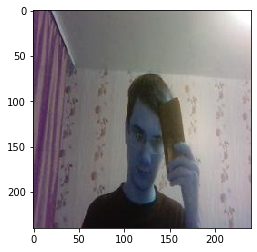

In [ ]:
for root, dirs, files in os.walk(test_phone_path):
    for file in files:
      show_predict(os.path.join(test_phone_path, file))

(array([[1.]], dtype=float32), 'phone')


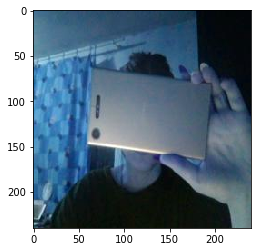

(array([[1.]], dtype=float32), 'phone')


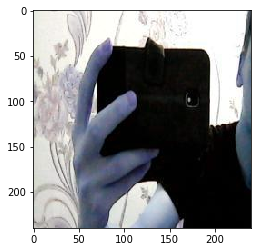

(array([[1.3879935e-28]], dtype=float32), 'no')


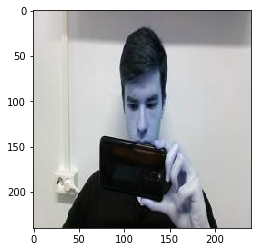

(array([[1.]], dtype=float32), 'phone')


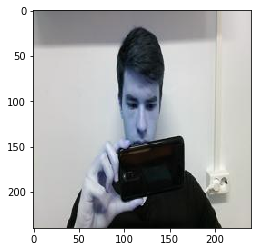

(array([[1.]], dtype=float32), 'phone')


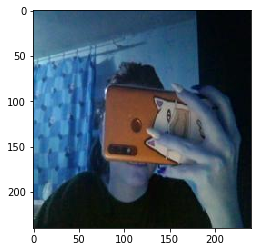

(array([[1.]], dtype=float32), 'phone')


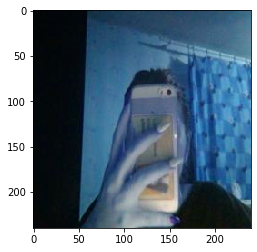

(array([[1.]], dtype=float32), 'phone')


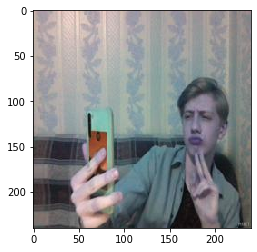

(array([[1.]], dtype=float32), 'phone')


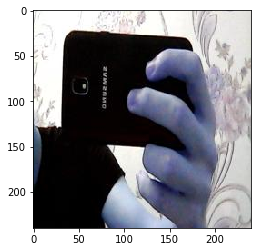

(array([[1.]], dtype=float32), 'phone')


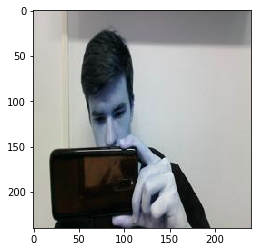

(array([[1.]], dtype=float32), 'phone')


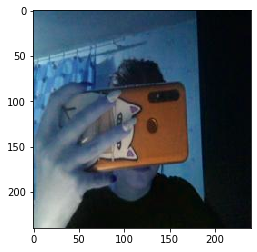

(array([[1.]], dtype=float32), 'phone')


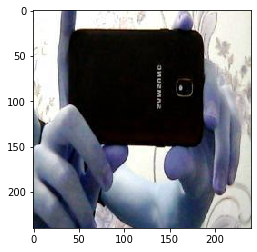

(array([[0.99999964]], dtype=float32), 'phone')


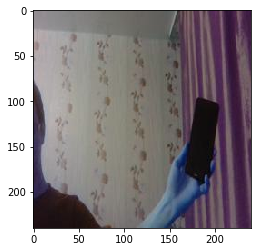

(array([[1.]], dtype=float32), 'phone')


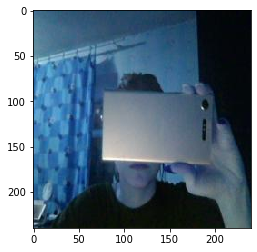

(array([[1.]], dtype=float32), 'phone')


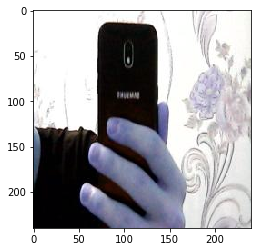

(array([[1.5638187e-33]], dtype=float32), 'no')


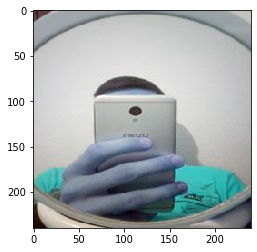

(array([[1.]], dtype=float32), 'phone')


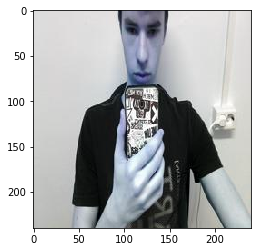

(array([[1.]], dtype=float32), 'phone')


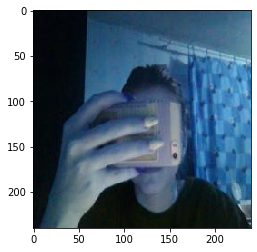

(array([[1.]], dtype=float32), 'phone')


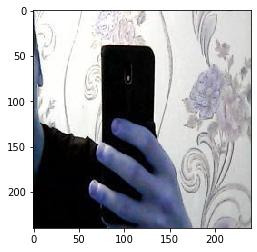

(array([[1.]], dtype=float32), 'phone')


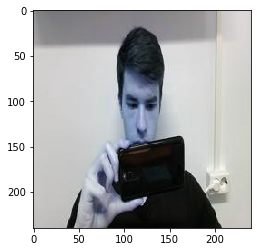

(array([[1.]], dtype=float32), 'phone')


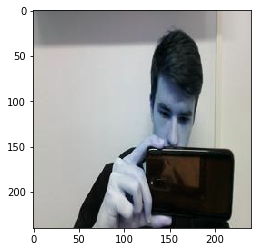

(array([[1.3772749e-05]], dtype=float32), 'no')


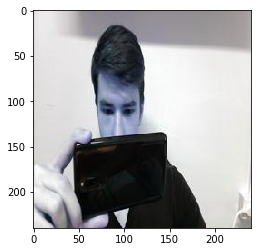

(array([[0.9999893]], dtype=float32), 'phone')


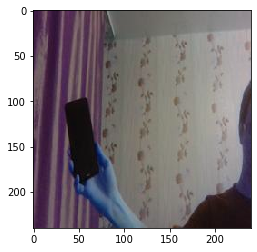

(array([[1.]], dtype=float32), 'phone')


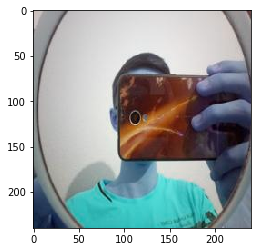

(array([[1.]], dtype=float32), 'phone')


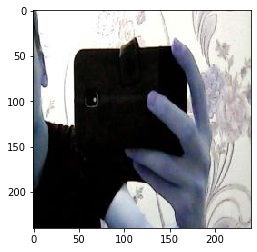

(array([[1.]], dtype=float32), 'phone')


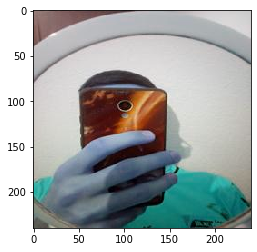

(array([[1.]], dtype=float32), 'phone')


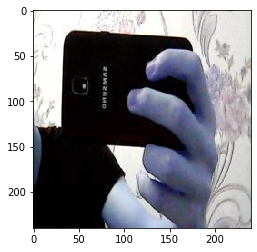

(array([[1.3948193e-28]], dtype=float32), 'no')


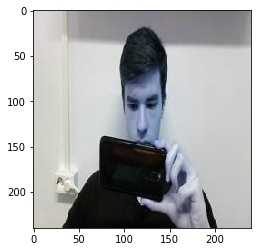

(array([[1.]], dtype=float32), 'phone')


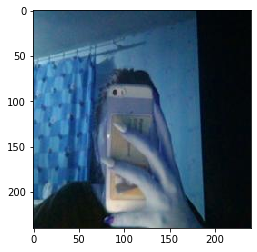

(array([[1.]], dtype=float32), 'phone')


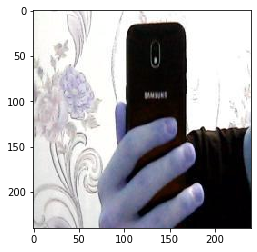

(array([[0.99999833]], dtype=float32), 'phone')


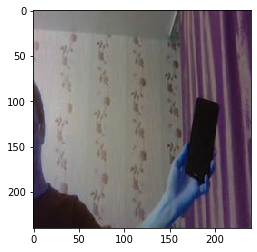

(array([[1.]], dtype=float32), 'phone')


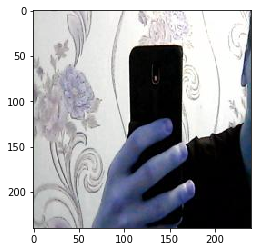

(array([[1.]], dtype=float32), 'phone')


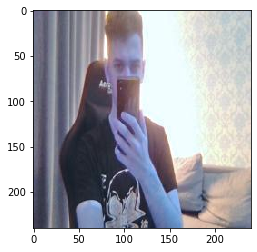

(array([[1.]], dtype=float32), 'phone')


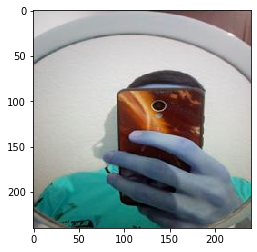

(array([[1.]], dtype=float32), 'phone')


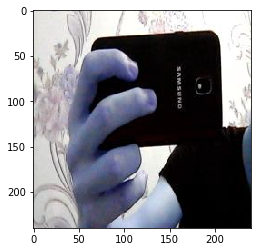

(array([[1.]], dtype=float32), 'phone')


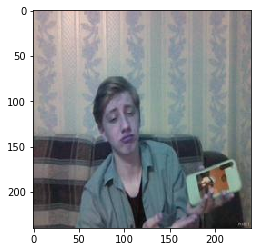

(array([[1.]], dtype=float32), 'phone')


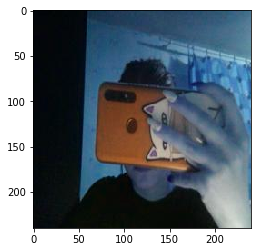

(array([[1.]], dtype=float32), 'phone')


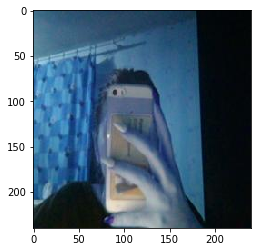

(array([[1.]], dtype=float32), 'phone')


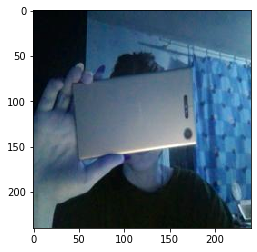

(array([[0.9998777]], dtype=float32), 'phone')


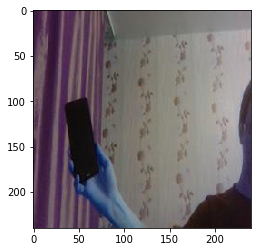

(array([[1.]], dtype=float32), 'phone')


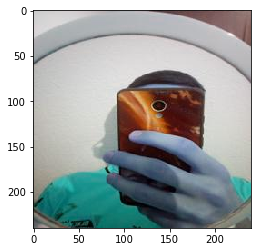

(array([[1.]], dtype=float32), 'phone')


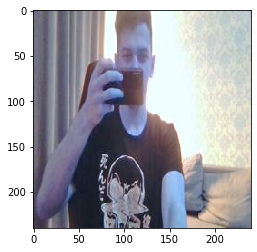

(array([[1.]], dtype=float32), 'phone')


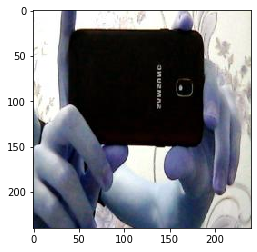

(array([[6.4643297e-29]], dtype=float32), 'no')


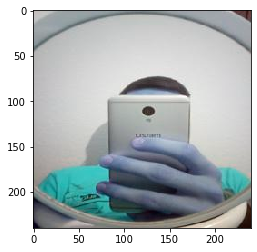

(array([[1.]], dtype=float32), 'phone')


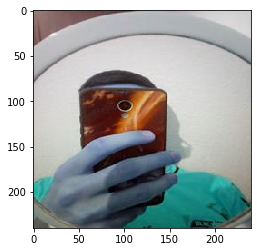

(array([[1.]], dtype=float32), 'phone')


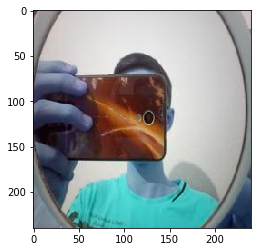

(array([[1.8017317e-07]], dtype=float32), 'no')


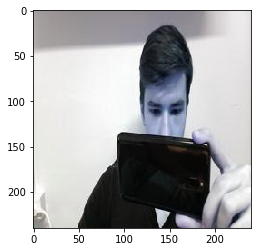

(array([[1.]], dtype=float32), 'phone')


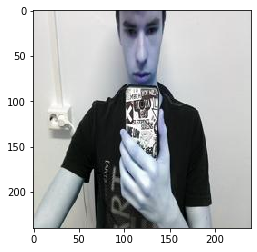

(array([[1.]], dtype=float32), 'phone')


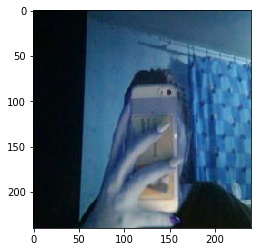

(array([[1.]], dtype=float32), 'phone')


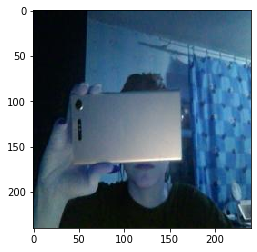

(array([[1.]], dtype=float32), 'phone')


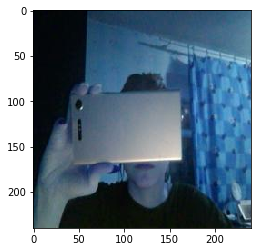

(array([[1.]], dtype=float32), 'phone')


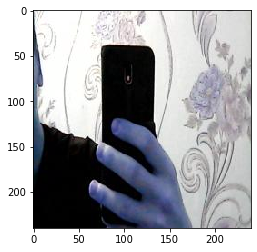

(array([[1.]], dtype=float32), 'phone')


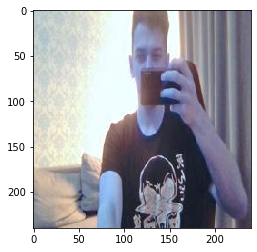

(array([[2.7220067e-06]], dtype=float32), 'no')


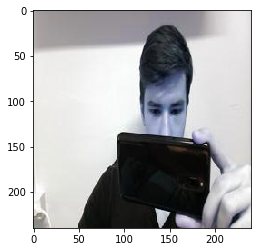

(array([[1.]], dtype=float32), 'phone')


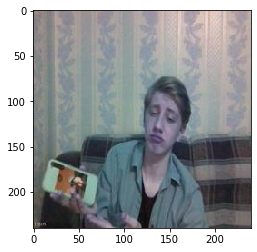

(array([[1.]], dtype=float32), 'phone')


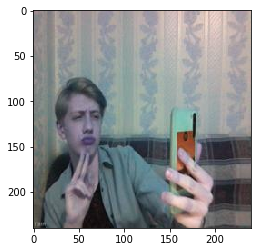

(array([[1.]], dtype=float32), 'phone')


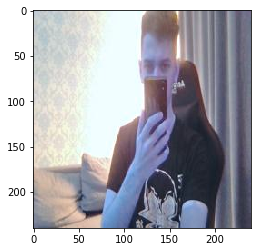

(array([[1.]], dtype=float32), 'phone')


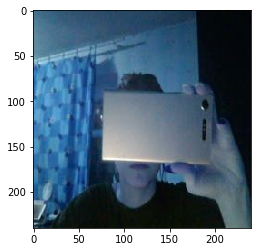

(array([[1.]], dtype=float32), 'phone')


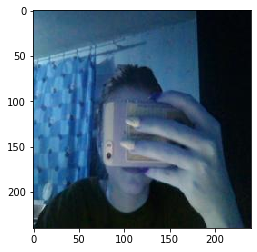

(array([[1.]], dtype=float32), 'phone')


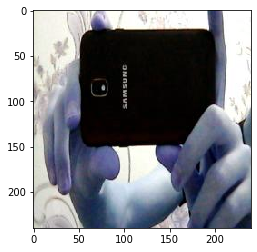

(array([[1.]], dtype=float32), 'phone')


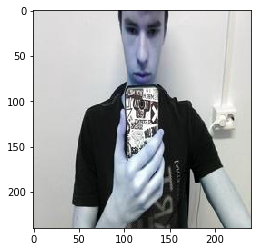

(array([[1.]], dtype=float32), 'phone')


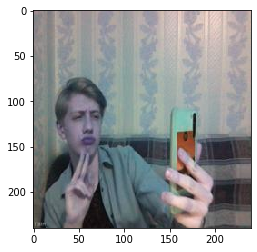

(array([[1.]], dtype=float32), 'phone')


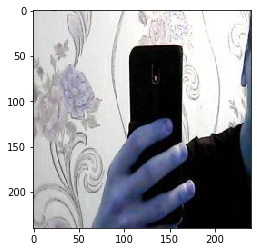

(array([[1.]], dtype=float32), 'phone')


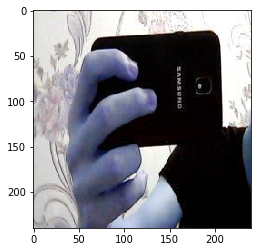

(array([[1.]], dtype=float32), 'phone')


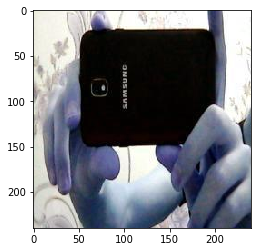

(array([[1.]], dtype=float32), 'phone')


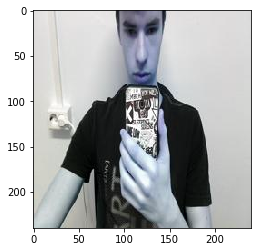

(array([[1.]], dtype=float32), 'phone')


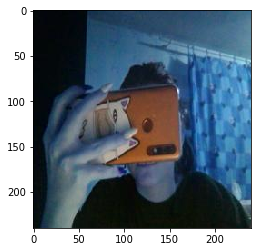

(array([[5.221978e-05]], dtype=float32), 'no')


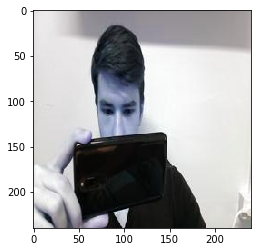

(array([[1.]], dtype=float32), 'phone')


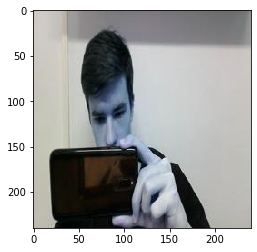

(array([[1.]], dtype=float32), 'phone')


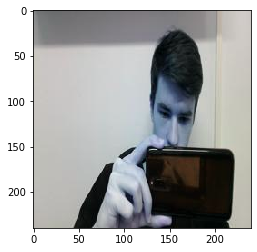

(array([[1.]], dtype=float32), 'phone')


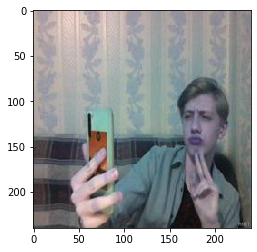

(array([[1.]], dtype=float32), 'phone')


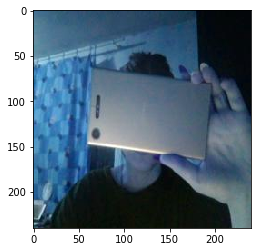

(array([[1.]], dtype=float32), 'phone')


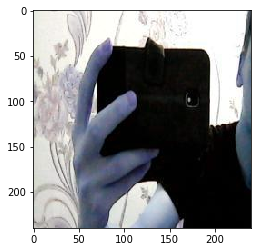

(array([[1.3879935e-28]], dtype=float32), 'no')


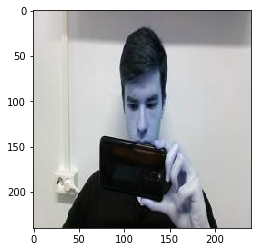

(array([[1.]], dtype=float32), 'phone')


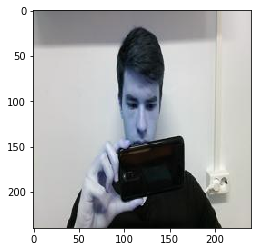

(array([[1.]], dtype=float32), 'phone')


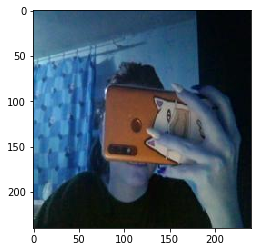

(array([[1.]], dtype=float32), 'phone')


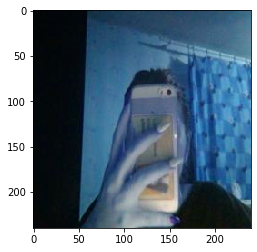

(array([[1.]], dtype=float32), 'phone')


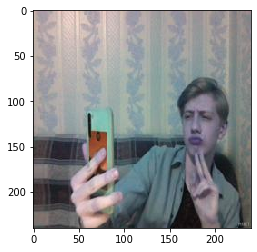

(array([[1.]], dtype=float32), 'phone')


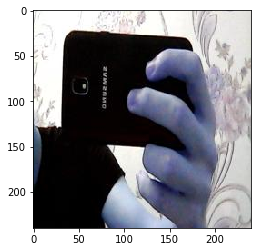

(array([[1.]], dtype=float32), 'phone')


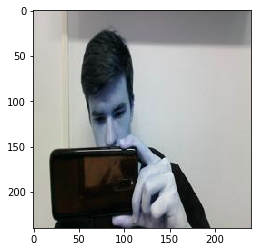

(array([[1.]], dtype=float32), 'phone')


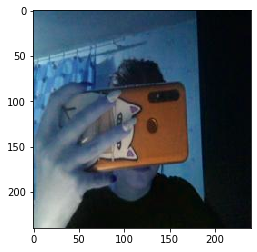

(array([[1.]], dtype=float32), 'phone')


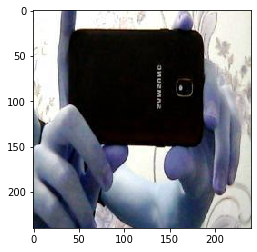

(array([[0.99999964]], dtype=float32), 'phone')


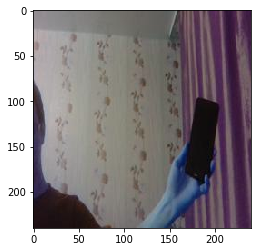

(array([[1.]], dtype=float32), 'phone')


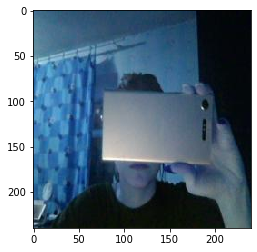

(array([[1.]], dtype=float32), 'phone')


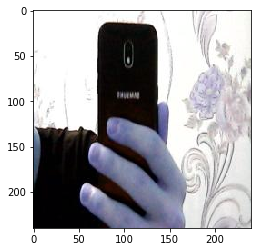

(array([[1.5638187e-33]], dtype=float32), 'no')


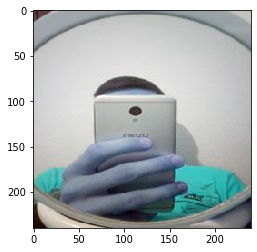

(array([[1.]], dtype=float32), 'phone')


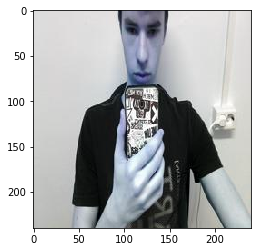

(array([[1.]], dtype=float32), 'phone')


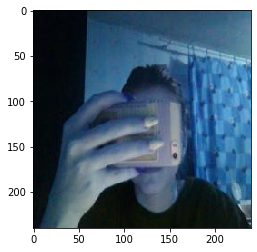

(array([[1.]], dtype=float32), 'phone')


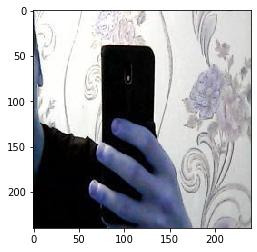

(array([[1.]], dtype=float32), 'phone')


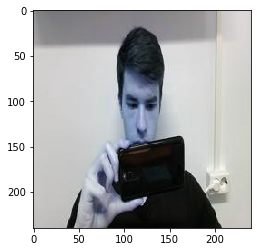

(array([[1.]], dtype=float32), 'phone')


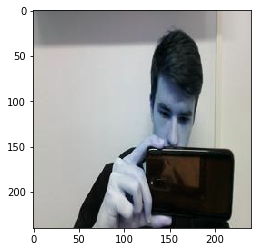

(array([[1.3772749e-05]], dtype=float32), 'no')


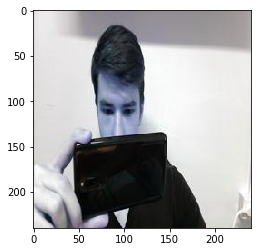

(array([[0.9999893]], dtype=float32), 'phone')


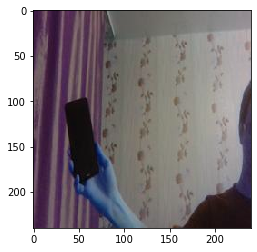

(array([[1.]], dtype=float32), 'phone')


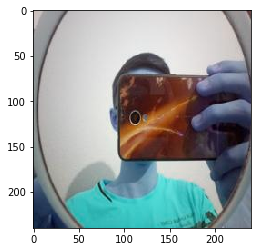

(array([[1.]], dtype=float32), 'phone')


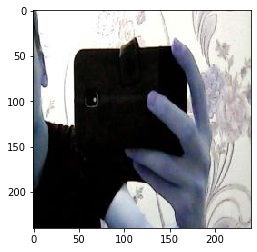

(array([[1.]], dtype=float32), 'phone')


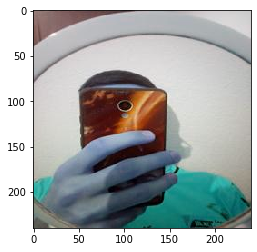

(array([[1.]], dtype=float32), 'phone')


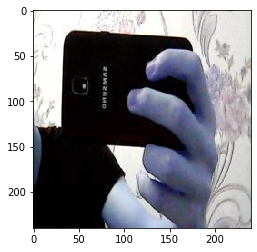

(array([[1.3948193e-28]], dtype=float32), 'no')


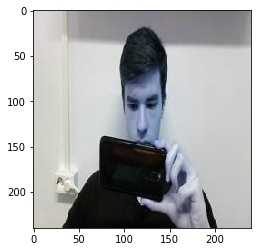

(array([[1.]], dtype=float32), 'phone')


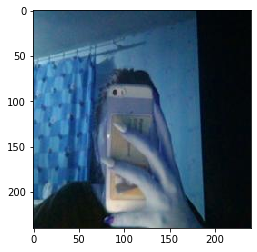

(array([[1.]], dtype=float32), 'phone')


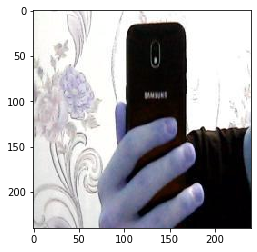

(array([[0.99999833]], dtype=float32), 'phone')


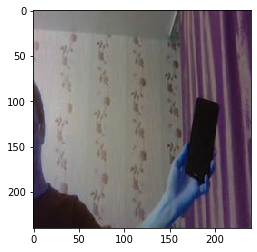

(array([[1.]], dtype=float32), 'phone')


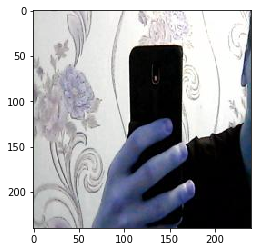

(array([[1.]], dtype=float32), 'phone')


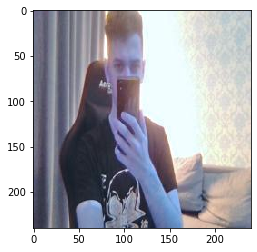

(array([[1.]], dtype=float32), 'phone')


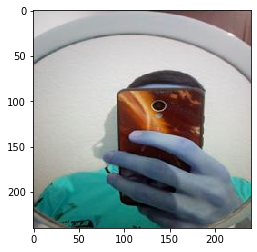

(array([[1.]], dtype=float32), 'phone')


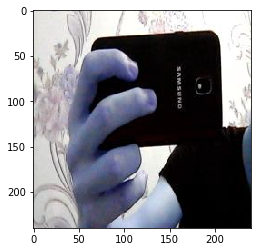

(array([[1.]], dtype=float32), 'phone')


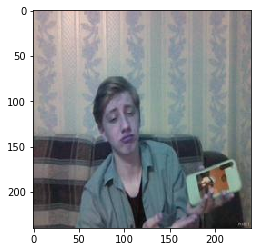

(array([[1.]], dtype=float32), 'phone')


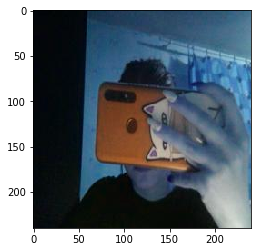

(array([[1.]], dtype=float32), 'phone')


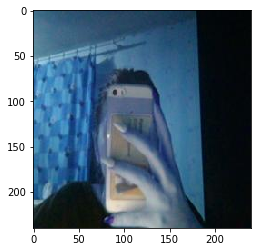

(array([[1.]], dtype=float32), 'phone')


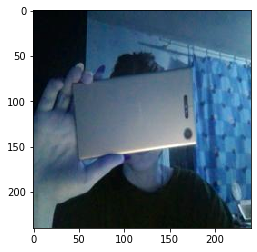

(array([[0.9998777]], dtype=float32), 'phone')


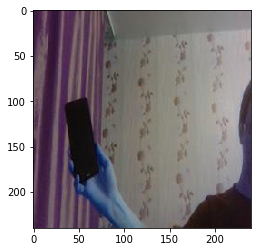

(array([[1.]], dtype=float32), 'phone')


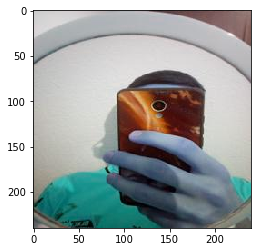

(array([[1.]], dtype=float32), 'phone')


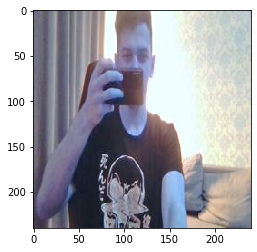

(array([[1.]], dtype=float32), 'phone')


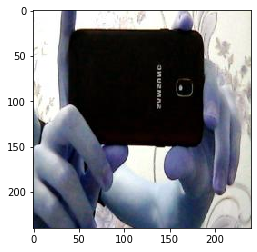

(array([[6.4643297e-29]], dtype=float32), 'no')


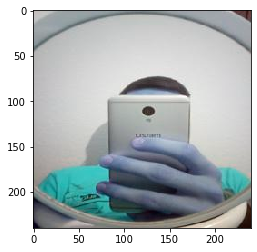

(array([[1.]], dtype=float32), 'phone')


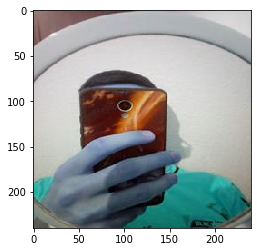

(array([[1.]], dtype=float32), 'phone')


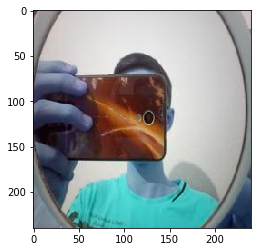

(array([[1.8017317e-07]], dtype=float32), 'no')


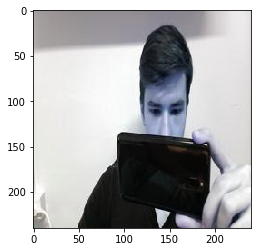

(array([[1.]], dtype=float32), 'phone')


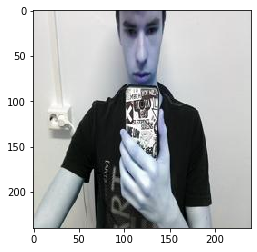

(array([[1.]], dtype=float32), 'phone')


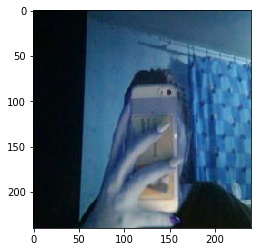

(array([[1.]], dtype=float32), 'phone')


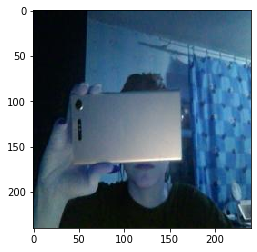

(array([[1.]], dtype=float32), 'phone')


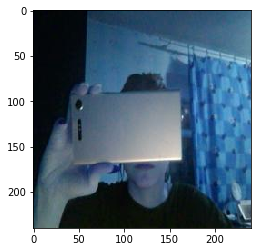

(array([[1.]], dtype=float32), 'phone')


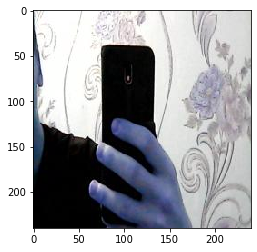

(array([[1.]], dtype=float32), 'phone')


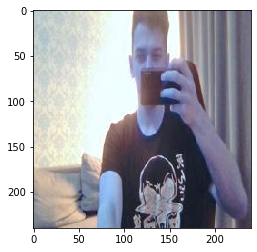

(array([[2.7220067e-06]], dtype=float32), 'no')


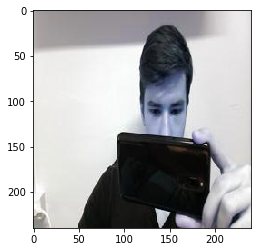

(array([[1.]], dtype=float32), 'phone')


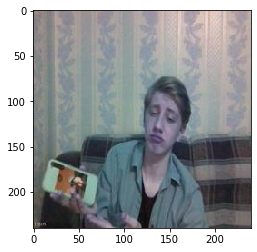

(array([[1.]], dtype=float32), 'phone')


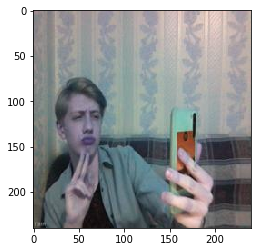

(array([[1.]], dtype=float32), 'phone')


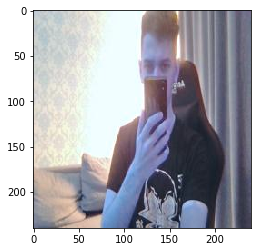

(array([[1.]], dtype=float32), 'phone')


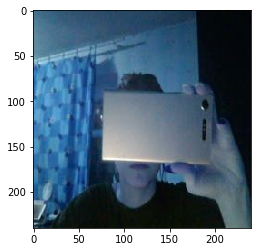

(array([[1.]], dtype=float32), 'phone')


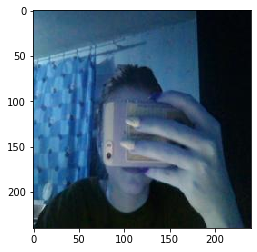

(array([[1.]], dtype=float32), 'phone')


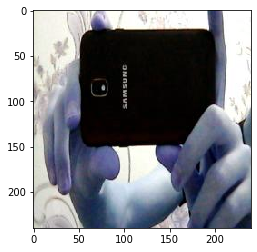

(array([[1.]], dtype=float32), 'phone')


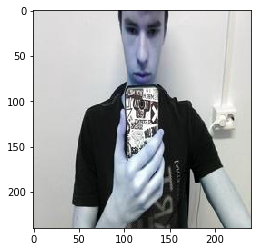

(array([[1.]], dtype=float32), 'phone')


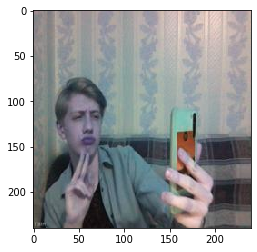

(array([[1.]], dtype=float32), 'phone')


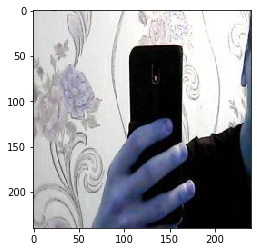

(array([[1.]], dtype=float32), 'phone')


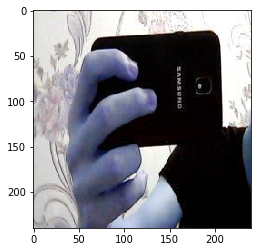

(array([[1.]], dtype=float32), 'phone')


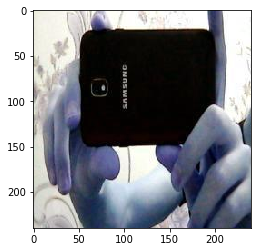

(array([[1.]], dtype=float32), 'phone')


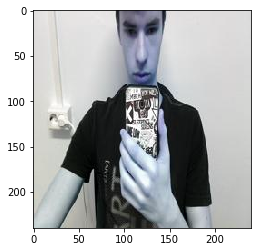

(array([[1.]], dtype=float32), 'phone')


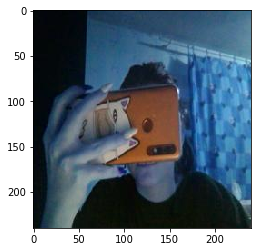

(array([[5.221978e-05]], dtype=float32), 'no')


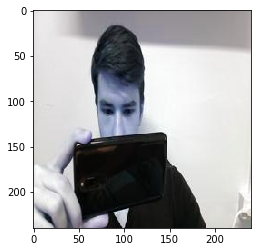

(array([[1.]], dtype=float32), 'phone')


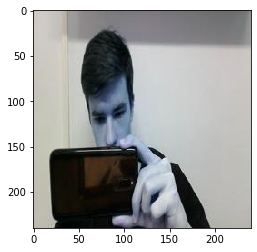

(array([[1.]], dtype=float32), 'phone')


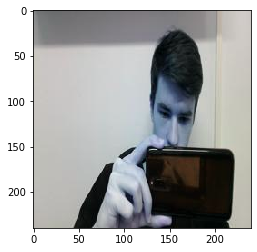

(array([[1.]], dtype=float32), 'phone')


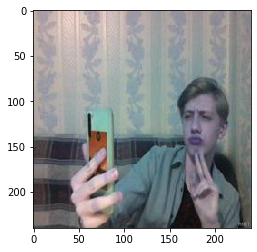

In [ ]:
for root, dirs, files in os.walk(work_test):
    for file in files:
      show_predict(os.path.join(work_test, file))